# Examples

# 1. Interactive tools

### 1.1 manual pixel-wise segmentation

In [1]:
import cracktools as ct
import matplotlib.pyplot as plt
import numpy as np

Find list of all names of images in a specific folder (by default 'cracktools/crackimages/') and showing specific image

In [5]:
images_names[0]

'361.JPG'

In [6]:
images_names = ct.tools.get_files(folder = 'crack images',formats = ['png','jpg'],basename = False)
image = ct.tools.image_load(images_names[0])

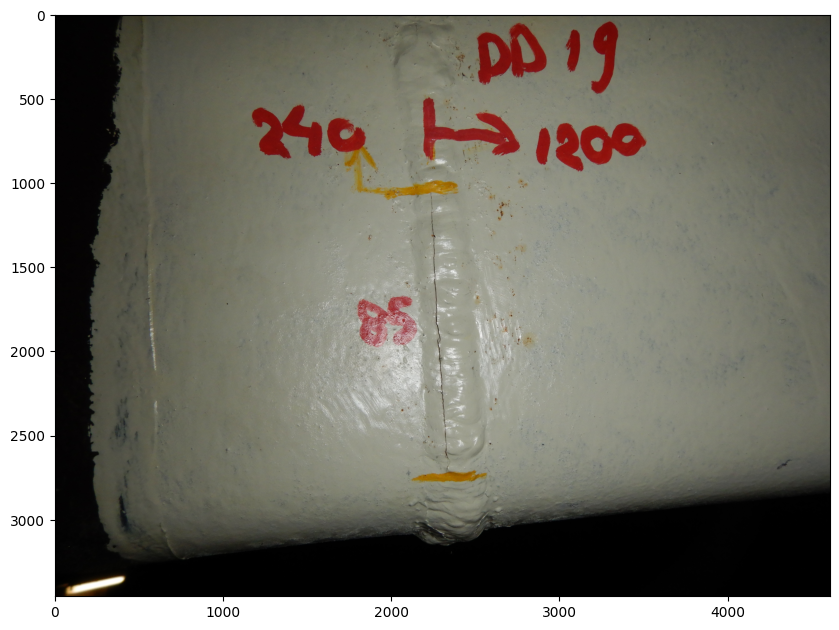

In [7]:
ct.tools.show_image(image,frame_size = 10)

Draw counturs of a crack and save coordinates in x and y variables

Controls:
1. Mous wheel for zoom in and zoom out
2. Press and hold left mouse button to start draw countur part
3. Release left mause button to fix the countur part
4. Press right mouse button to erase previous countur part

In [8]:
x,y = ct.tools.Draw().counturs(image[:,:,::-1],3)

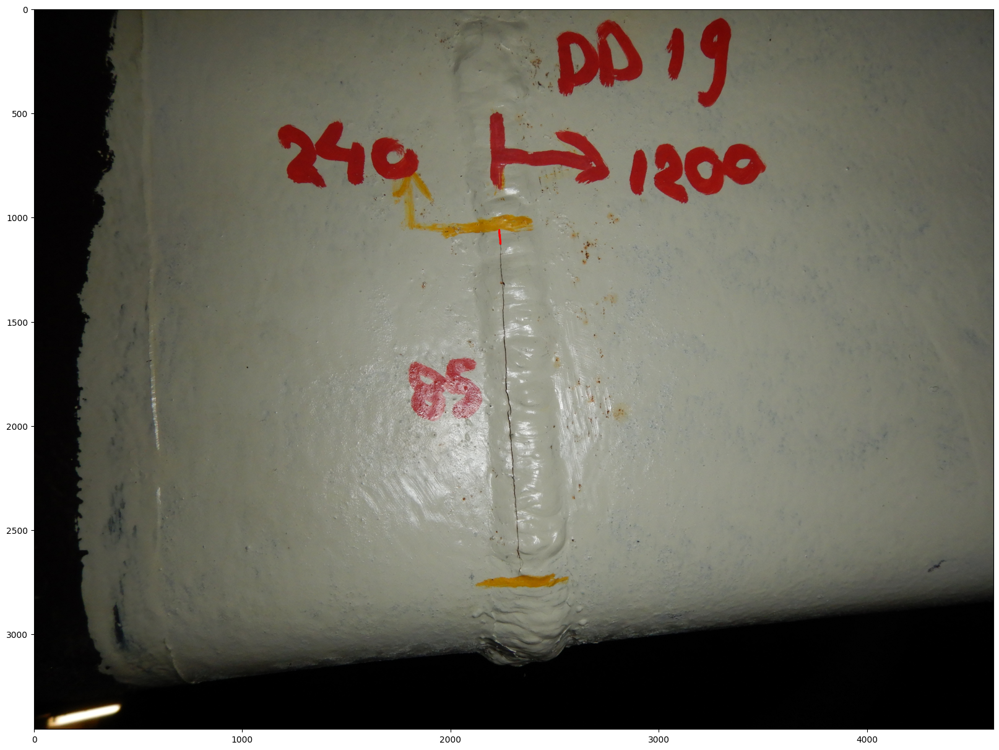

In [9]:
ct.tools.show_image(image,frame_size = 20)
plt.plot(x,y,'r')

### 1.2 Select points on image

Zoom in, zoom out with mouse wheel.

LMB - to select point;

RMB - to undo previous selection

In [10]:
pts = ct.tools.Draw().points(image[:,:,::-1],3)

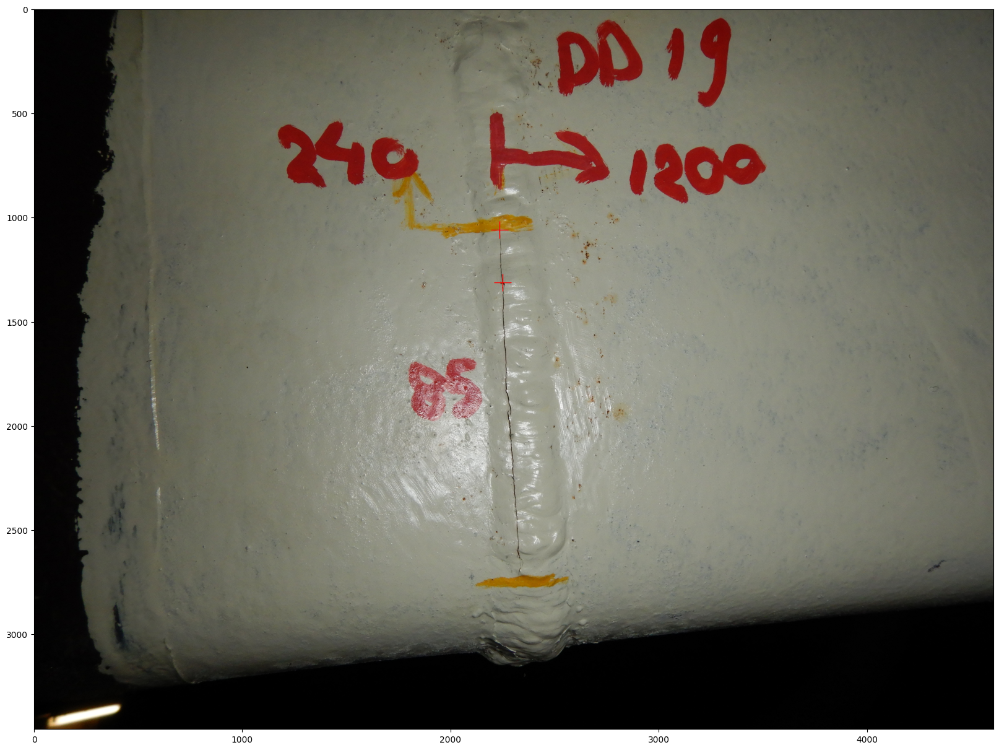

In [11]:
ct.tools.show_image(image,frame_size = 20)
plt.plot(np.array(pts)[:,0],np.array(pts)[:,1],'r+',markersize = 20)


# 2. Filters

### 2.1 Frangi filter

In [ ]:
import cracktools as ct

In [5]:
images_names = ct.tools.get_files()
image = ct.tools.image_load(images_names[4])

In [ ]:
pts = ct.tools.Draw().points(image[:,:,::-1],3)

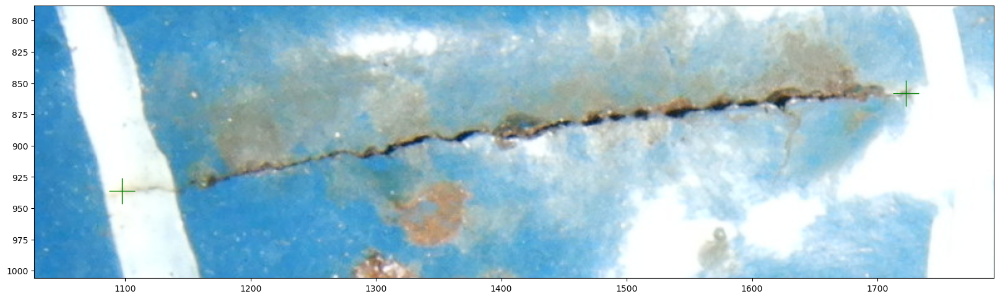

In [6]:
ct.tools.show_image(image,frame_size = 20,pts = pts,limits_y=70, limits_x=70,markersize=30)

In [7]:
image_crop,pts_crop = ct.tools.image_crop(image,pts[0],pts[1],pts,2,2)

In [8]:
frangi = ct.hessian_based_filters.frangi_modified(image_crop, sigmas=range(1, 4, 1), alpha=0.5, beta=0.5, gamma=0.1,
           black_ridges=True, mode='reflect', cval=0, sigma_mode = 'max')

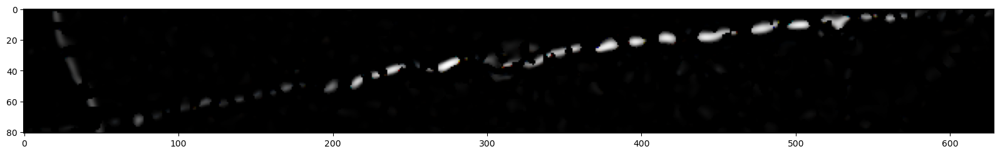

In [9]:
ct.tools.show_image(ct.tools.scale_image(frangi),frame_size = 20,pts = pts,markersize=30)

### 2.2 Visualisation of image hessian eigenvectors

Hessian element df/dx/dx


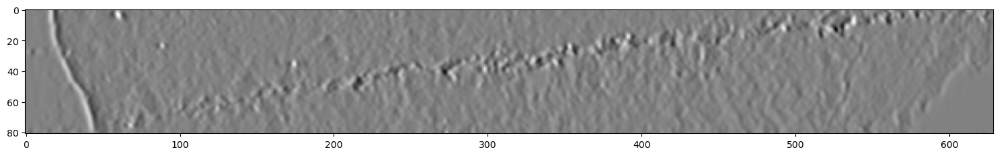

Hessian element df/dy/dx


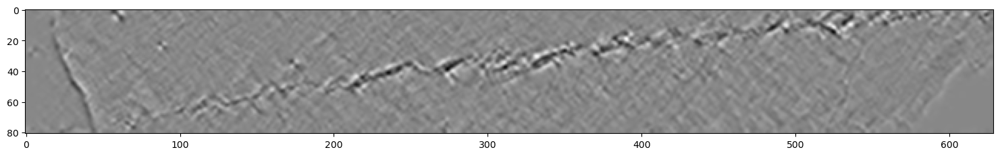

Hessian element df/dy/dy


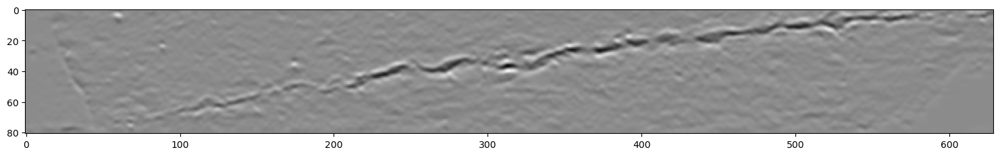

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


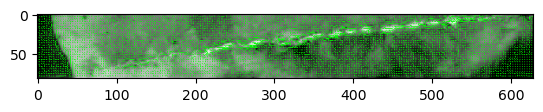

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


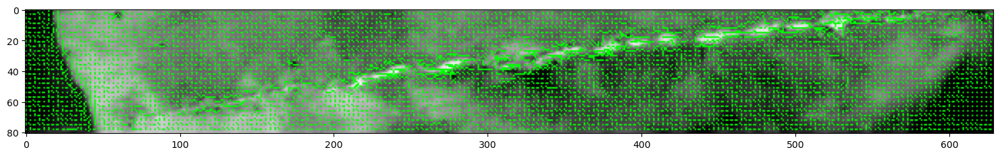

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


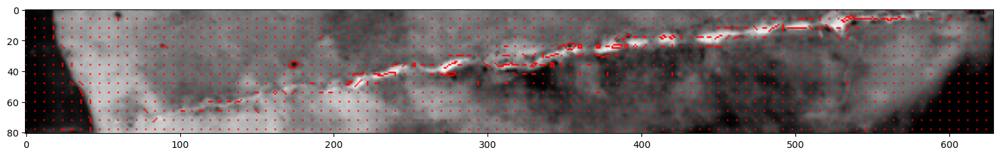

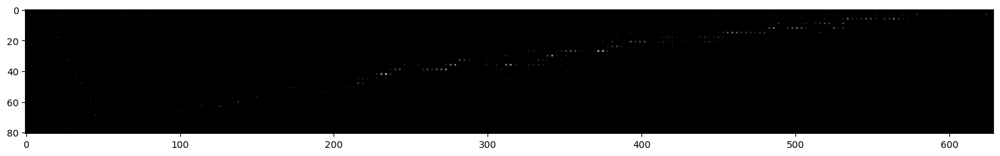

array([[2.28838978e-09, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 3.16151652e-05, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       ...,
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00]])

In [18]:
ct.hessian_based_filters.my_frangi_visualize(image_crop[:,:,0], alpha=0.5, beta=0.5, gamma=1,sigmas=np.arange(1,2,1),black_ridges=True,
                     sigma_mode = 'max',comput_skip = 3,arrow_skip = 3,
                                         arrow_mult = 70, arrow_thickness = 1, ellipse_skip = 6,
                                         ellipse_mult = 50, ellipse_thickness =1, ellipse_division = 1)

### 2.3 Orientation scores

In [1]:
import cracktools as ct
import matplotlib.pyplot as plt

In [2]:
images_names = ct.tools.get_files()
image = ct.tools.image_load(images_names[4])

In [3]:
pts = ct.tools.Draw().points(image[:,:,::-1],3)

In [4]:
image_crop,pts_crop = ct.tools.image_crop(image,pts[0],pts[1],pts,10,10)

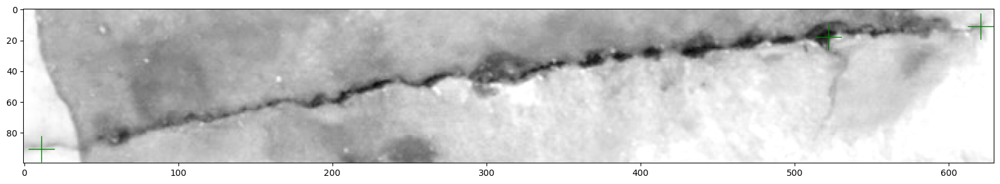

In [5]:
color_channel = 2

ct.tools.show_image(image_crop[:,:,color_channel],frame_size = 20,pts = pts_crop,markersize=30)

design cake-wavelet

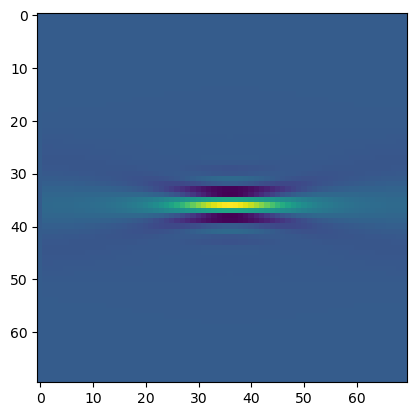

In [6]:
size = 70
nOrientations = 32
design = "N"
inflectionPoint = 0.5
mnOrder = 8
splineOrder = 3
overlapFactor = 1
dcStdDev = 8
directional = False
window_size = 70

ct.os.CheckWavelet(window_size = window_size, size = size, nOrientations = nOrientations, design = design, 
                inflectionPoint = inflectionPoint, mnOrder = mnOrder, splineOrder = splineOrder,
                overlapFactor = overlapFactor, dcStdDev = dcStdDev, directional = directional,
                display_orientations=[8])

compare cake-wavelet with crack

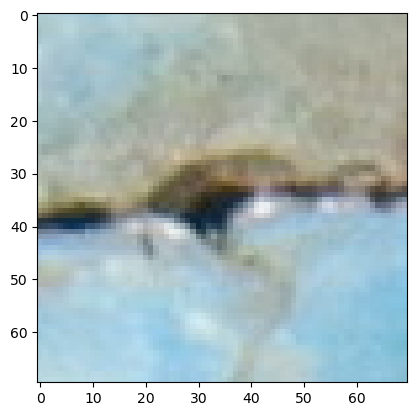

In [7]:
d = int(window_size/2)
fig = plt.figure()
# fig.set_size_inches(18.5, 10.5)
plt.imshow(image[int(pts[2][1])-d:int(pts[2][1])+d,int(pts[2][0])-d:int(pts[2][0])+d],cmap = 'gray')

calculate orientation score

In [8]:
osGFCost = ct.os.OrientationScoreTransform(image_crop[:,:,color_channel]/255, size = size, nOrientations = nOrientations, design = design, inflectionPoint = inflectionPoint, mnOrder = mnOrder, splineOrder = splineOrder,
                              overlapFactor = overlapFactor, dcStdDev = dcStdDev, directional = directional)

visualasie orientation score

In [22]:
import plotly
import plotly.graph_objects as go
import numpy as np
import scipy

shift = -30
osGFCost_shift = np.roll(osGFCost, shift=shift,axis = 0)
osGFCost_shift.shape

downsample_rate_spatial = 10
downsample_rate_angular = 1
# angular_shift = int(1*osGFCost.shape[0])
# osGFCosts = 
values = osGFCost_shift[:int(osGFCost.shape[0]/2):downsample_rate_angular,
                  0::downsample_rate_spatial,1::downsample_rate_spatial].real
X, Y, Z = np.mgrid[:values.shape[0]*downsample_rate_angular:downsample_rate_angular,
                   :values.shape[1]*downsample_rate_spatial:downsample_rate_spatial,
                   :values.shape[2]*downsample_rate_spatial:downsample_rate_spatial]
image_gray_cropp_down = scipy.ndimage.zoom(image_crop[:,:,color_channel], 
                                           ((Y.shape[1])/image_crop.shape[0],
                                                              (Y.shape[2])/image_crop.shape[1]), order=3)

yim = np.linspace(0,image_crop.shape[0],image_crop.shape[0])
zim = np.linspace(0,image_crop.shape[1],image_crop.shape[1])
yim,zim = np.meshgrid(yim,zim)
xim = np.ones(yim.shape)*0

a = osGFCost.shape[0]/2-1
b = osGFCost.shape[1]
c = osGFCost.shape[2]

fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=values.flatten(),
    isomin=np.min(values),
    isomax=np.max(values),
    opacity=1, # needs to be small to see through all surfaces
    opacityscale='min',
    colorscale='Hot',
#     surface_count=10, # needs to be a large number for good volume rendering
    caps= dict(x_show=False, y_show=False, z_show=False, x_fill=1),
#     slices_x=dict(show=True, locations=[10]),
#     surface=dict(fill=0.5, pattern='even'),
))
# fig.update_traces(contour=dict(show = True), selector=dict(type='volume'))
# fig.update_traces(flatshading=False, selector=dict(type='volume'))
fig.update_traces(lighting=dict(ambient = 0.4,diffuse = 0.9,fresnel = 0.8,roughness = 0.5,specular = 0.05),
                  selector=dict(type='volume'))

# fig.update_traces(spaceframe=dict(fill = 0.01,show = False), selector=dict(type='volume'))

fig.update_traces(surface=dict(count=5,fill = 1,pattern='all',show=True), selector=dict(type='volume'))

# fig.update_layout(scene_aspectmode='manual',
#                   scene_aspectratio=dict(x=0.5, y=1, z=1*values.shape[2]/values.shape[1]))

r = image_crop.shape[0]/image_crop.shape[1]
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=0.1, y=r, z=1))

fig.update_layout(scene_xaxis_showticklabels=False,
                  scene_yaxis_showticklabels=False,
                  scene_zaxis_showticklabels=False),


fig.add_surface(x=xim, y=yim, z=zim, 
                surfacecolor=image_crop[:,:,color_channel].T, 
                colorscale='gray', 
                showscale=False)

fig.add_scatter3d(
        x=[0, 0, a, a, 0, 0, a, a, a, 0, 0, 0, 0, a, a, a],
        y=[0, b, b, 0, 0, 0, 0, b, b, b, b, 0, b, b, 0, 0],
        z=[0, 0, 0, 0, 0, c, c, c, 0, 0, c, c, c, c, c, 0],
    mode = 'lines',
    line=dict(
        color='black',
        width=2
    )
)

fig.update_layout(scene = dict(
                    xaxis = dict(showbackground=False),
                    yaxis = dict(showbackground=False),
                    zaxis = dict(showbackground=False)))
fig.update_layout(scene = dict(
                    xaxis_title="θ",
                    yaxis_title='x1',
                    zaxis_title='x2'))

# fig.add_scatter3d( x=geodesics[0][:,2]*osGFCost.shape[0]/2/np.pi+shift, y=geodesics[0][:,0], z=geodesics[0][:,1],
#                     mode = 'lines',
#                     line=dict(
#                     color='green',
#                     width=30))

# fig.add_scatter3d( x=np.zeros_like(geodesics[0][:,0])+2, y=geodesics[0][:,0], z=geodesics[0][:,1],
#                     mode = 'lines',
#                     line=dict(
#                     color='green',
#                     width=30))


# fig.add_scatter3d( x=[0,geodesics[0][0,2]*osGFCost.shape[0]/2/np.pi+shift], y=[geodesics[0][0,0],geodesics[0][0,0]],
#                   z=[geodesics[0][0,1],geodesics[0][0,1]],
#                     mode = "lines+markers",
#                     marker=dict(
#                     color='blue',
#                     size=30),
#                      line = dict(dash='dash',
#                     color='blue',
#                     width=30))
# fig.add_scatter3d( x=[0,geodesics[0][-1,2]*osGFCost.shape[0]/2/np.pi+shift], y=[geodesics[0][-1,0],geodesics[0][-1,0]], z=[geodesics[0][-1,1],geodesics[0][-1,1]],
#                     mode = "lines+markers",
#                     marker=dict(
#                     color='blue',
#                     size=30),
#                     line = dict(dash='dash',
#                     color='blue',
#                     width=30))



# fig.update_traces(showlegend=False)
fig.update_traces(showscale=True, selector=dict(type='volume'))
# fig.update_layout(width=4000, height=2000,margin=dict(t=40, r=0, l=20, b=20))
fig.update_layout(margin_autoexpand=True)
fig.update_layout(font=dict(size = 60))
# name = 'default'
# # Default parameters which are used when `layout.scene.camera` is not provided
# camera = dict(
#     up=dict(x=0, y=0, z=1),
#     center=dict(x=0, y=0, z=0),
#     eye=dict(x=1.25, y=1.25, z=1.25)
# )

# fig.update_layout(scene_camera=camera, title=name)
# fig.show()
k = 4.5
camera = dict(
    up=dict(x=1, y=0, z=0),
    center=dict(x=-0.15, y=0, z=0),
    eye=dict(x=0.085*k, y=0.23*k, z=0.2*k)
)
fig.update_layout(scene_camera=camera,title='default')

fig.show()

line filter applied to orientation scores

In [25]:
ksi = 1
zeta = 1
sigmas = [1,2]
sigmas_ext = 1
multiscalecostLIFExtReg = ct.os.MultiScaleVesselness(osGFCost.real,ksi,1,sigmas,"LIF",sigmas_ext = sigmas_ext)

1
2


In [26]:
costmultiscale = ct.os.MultiScaleVesselnessFilter(multiscalecostLIFExtReg)
costFunction = ct.os.CostFunction(costmultiscale,lambdaa = 10, p = 2)
c00 = np.min(ct.os.Rescale(costFunction),axis = 0)

projection of orientation scores after application of 3d frangi filter

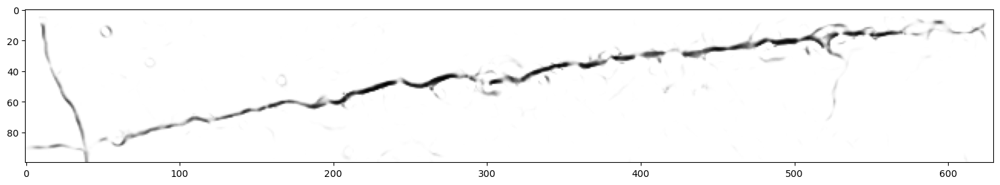

In [29]:
fig = plt.figure()
fig.set_size_inches(18.5, 10.5)
plt.imshow(c00,cmap = 'gray')

# 3. Tracking

### 3.1 FlyFisher and RouteFinder Tracking

#### Following code shows how to apply MPSmethod described in (Dare, P., Hanley, H., Fraser, C., Riedel, B., & Niemeier, W. (2002). An operational application of automatic feature extraction: the measurement of cracks in concrete structures. The Photogrammetric Record, 17(99), 453-464.)

##### a) Flyfisher

In [16]:
images_names = ct.tools.get_files()
image = ct.tools.image_load(images_names[4])

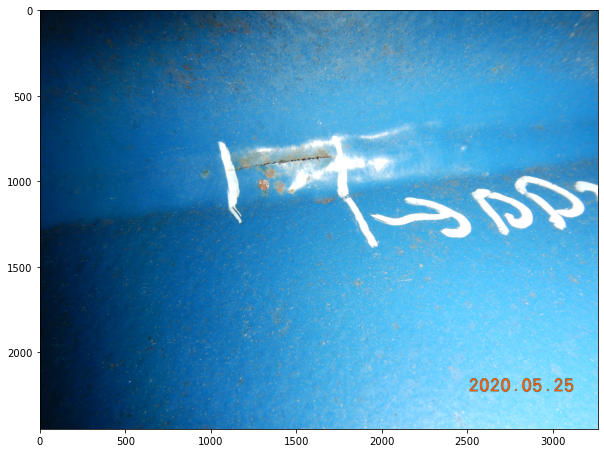

In [17]:
ct.tools.show_image(image,frame_size = 10)

In [19]:
pts = ct.tools.Draw().points(image[:,:,::-1],3)

In [20]:
pts

[array([1093.47977941,  939.55392157]), array([1724.66911765,  858.34313725])]

In [21]:
track = ct.tracking.Fly_fisher(image[:,:,2],pts[0],pts[1],
              n_directions = 50,search_range = 15,search_step = 1,move_step = 3,angle = 70)

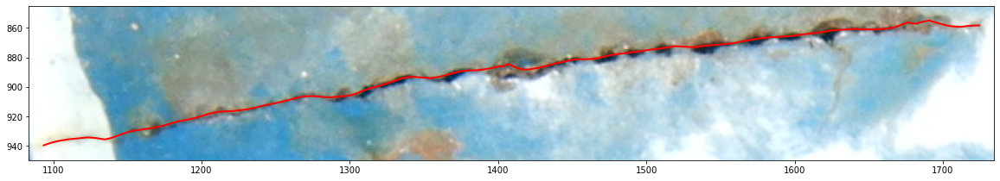

In [22]:
ct.tools.draw_track(image,track,frame_size = 20,limits_x = 10, limits_y = 10,track_color = 'r',track_width = 2)

##### b) RoutFinder

In [25]:
track = ct.tracking.Route_finder(image,pts[0],pts[1],
                long_step = 5,side_search_step = 0.5,
                 side_search_range = 15, interpolation_method='linear',color_method='Min')

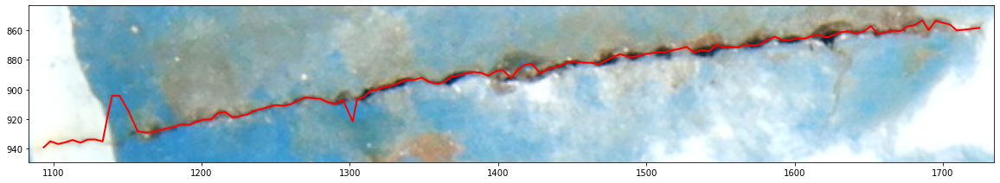

In [26]:
ct.tools.draw_track(image,track,frame_size = 20,limits_x = 10, limits_y = 10,track_color = 'r',track_width = 2)

### 3.2 Dijkstra's tracking

In [32]:
import cracktools as ct
import matplotlib.pyplot as plt
import numpy as np

In [33]:
images_names = ct.tools.get_files()
image = ct.tools.image_load(images_names[4])

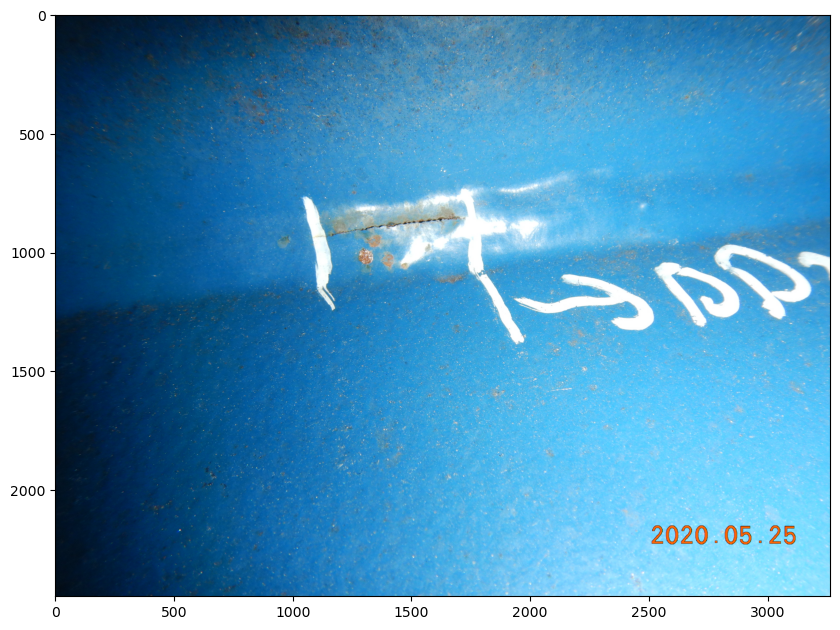

In [34]:
ct.tools.show_image(image,frame_size = 10)

In [35]:
pts = ct.tools.Draw().points(image[:,:,::-1],3)

In [36]:
y_margin = 20
x_margin = 5
image_crop,pts_crop = ct.tools.image_crop(image,pts[0],pts[1],pts,y_margin,x_margin)

IndexError: list index out of range

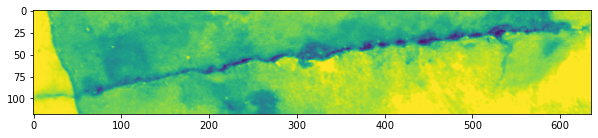

In [17]:
ct.tools.show_image(image_crop[:,:,2],frame_size = 10)

In [18]:
track_crop = ct.tracking.Dijsktra_grid(image_crop[:,:,2], pts_crop[0], pts_crop[1], transition_cost = None)

In [19]:
track = ct.tools.track_crop_to_full(track_crop,pts[0],pts[1],y_margin,x_margin)

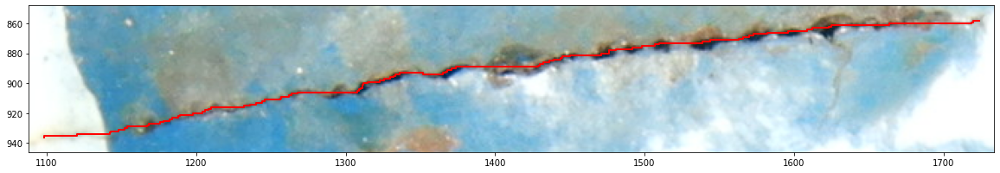

In [20]:
ct.tools.draw_track(image,track,frame_size = 20,limits_x = 10, limits_y = 10,track_color = 'r',track_width = 2)

### 3.3 MPS

#### Following code shows how to apply MPSmethod described in (Rabih Amhaz, Sylvie Chambon, Jérôme Idier, and Vincent Baltazart. Automatic crack detection on two-dimensional pavement images: An algorithm based on minimal path selection. IEEE Transactions on Intelligent Transportation Systems, 17(10):2718–2729, 2016)

In [4]:
image_gray = image[:,:,2]

In [10]:
P = 20
ke = 1
cells = ct.MPS.MPSStructure( int(np.ceil(image_gray.shape[0]/P)),int( np.ceil(image_gray.shape[1]/P)))
cells = ct.MPS.init_points(cells, image_gray, P = P, ke = ke)

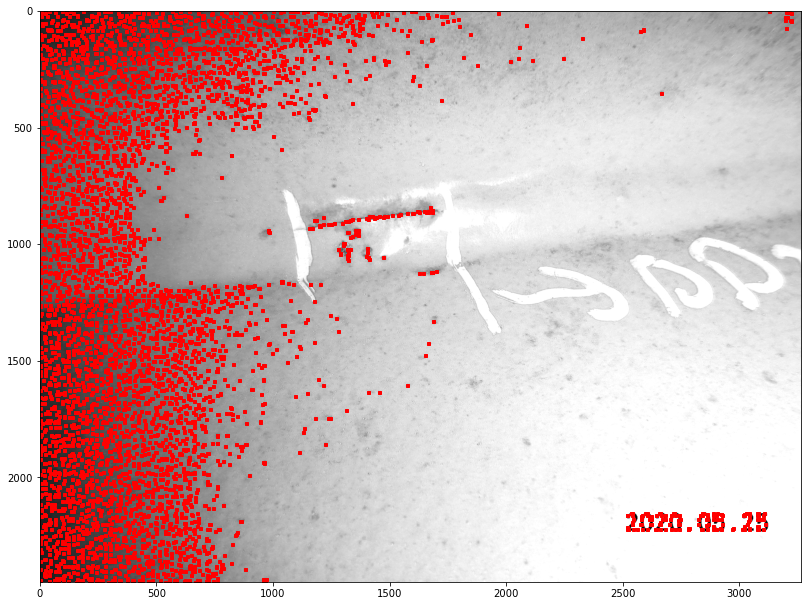

In [11]:
fig = plt.figure()
fig.set_size_inches(18.5, 10.5)
plt.imshow(image_gray,cmap = 'gray')
plotted = []
for i in range(cells.nodes.shape[0]):
    for j in range(cells.nodes.shape[1]):
        if cells.nodes[i,j].active:
                c =  cells.nodes[i,j].min_point_pos_image
                plt.plot(c[1],c[0],'rs',markersize = 3)

In [31]:
cells = ct.MPS.calc_paths(cells,image_gray)

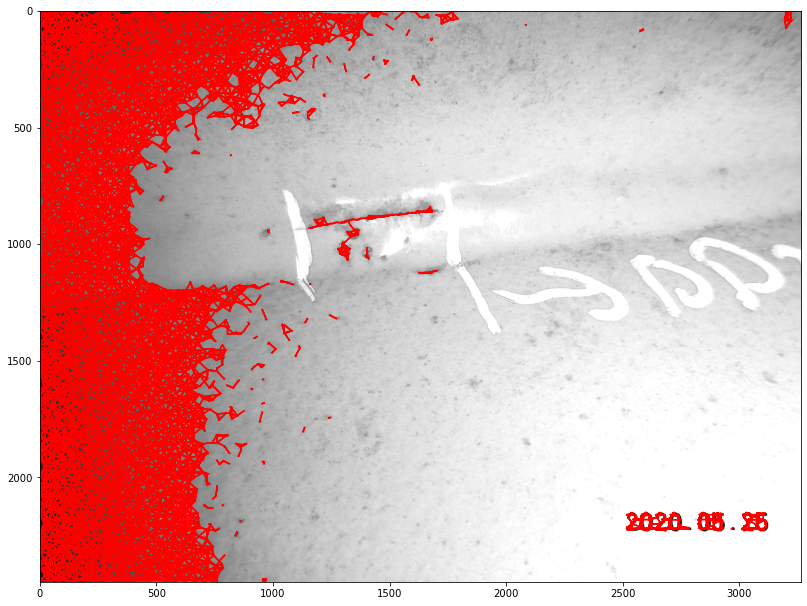

In [13]:
fig = plt.figure()
fig.set_size_inches(18.5, 10.5)
plt.imshow(image_gray,cmap = 'gray')
plotted = []
for i in range(cells.nodes.shape[0]):
    for j in range(cells.nodes.shape[1]):
        for p in range(cells.connections.shape[2]):
            if cells.connections[i,j,p].active:
                c =  cells.connections[i,j,p].path
                plt.plot(c[:,1],c[:,0],'r')
                

### 3.3 Fast marching algorithm on image R2 domain

In [1]:
import cracktools as ct
import matplotlib.pyplot as plt
import numpy as np

In [2]:
images_names = ct.tools.get_files()
image = ct.tools.image_load(images_names[4])

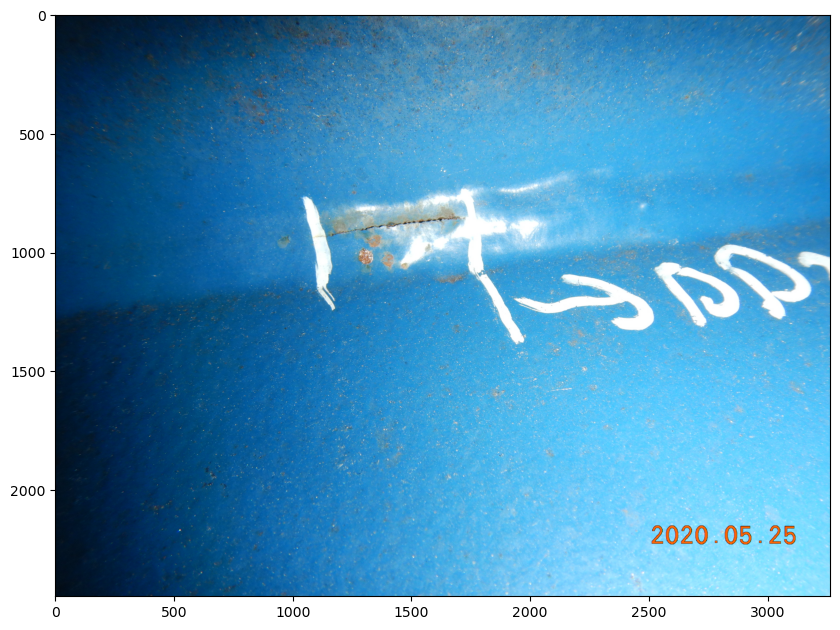

In [3]:
ct.tools.show_image(image,frame_size = 10)

In [4]:
pts = ct.tools.Draw().points(image[:,:,::-1],3)

In [5]:
y_margin = 20
x_margin = 5
image_crop,pts_crop = ct.tools.image_crop(image,pts[0],pts[1],pts,y_margin,x_margin)

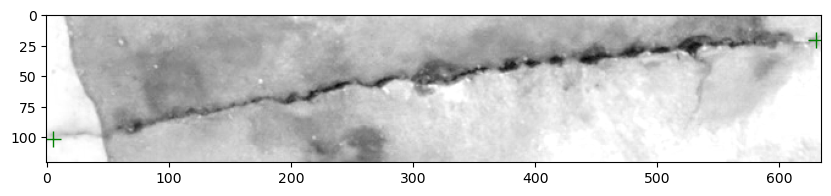

In [6]:
color_channel = 2

ct.tools.show_image(image_crop[:,:,color_channel],frame_size = 10, pts = pts_crop)

In [7]:
track_crop = ct.tracking.fast_marching_2d(image_crop[:,:,color_channel],pts_crop[0],pts_crop[1])

track = ct.tools.track_crop_to_full(track_crop,pts[0],pts[1],y_margin,x_margin)

Field verbosity defaults to 1
Field seedRadius defaults to 0
Fast marching solver completed in 0.048 s.
Field geodesicSolver defaults to Discrete
Field geodesicStep defaults to 0.25
Field geodesicWeightThreshold defaults to 0.001
Field geodesicVolumeBound defaults to 8.45
Done.


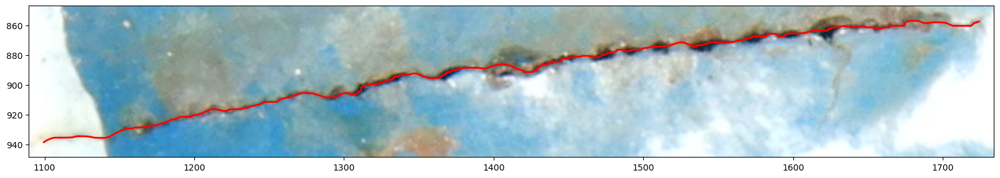

In [8]:
ct.tools.draw_track(image,track,frame_size = 20,limits_x = 10, limits_y = 10,track_color = 'r',track_width = 2)

### 3.4 Anisotropic fast marching in orientation scores

In [1]:
import cracktools as ct
import matplotlib.pyplot as plt
import numpy as np

In [2]:
images_names = ct.tools.get_files()
image = ct.tools.image_load(images_names[4])

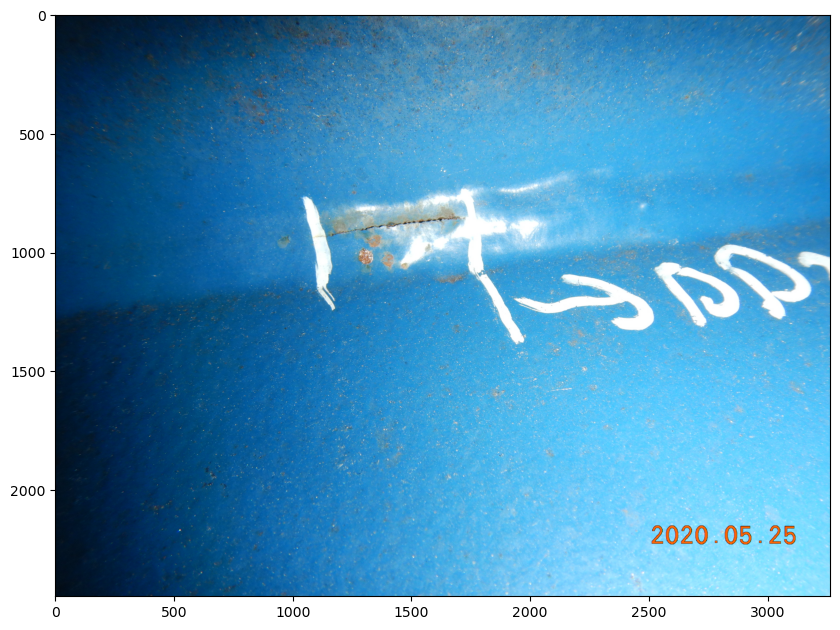

In [3]:
ct.tools.show_image(image,frame_size = 10)

In [4]:
pts = ct.tools.Draw().points(image[:,:,::-1],3)

In [5]:
y_margin = 20
x_margin = 5
image_crop,pts_crop = ct.tools.image_crop(image,pts[0],pts[1],pts,y_margin,x_margin)

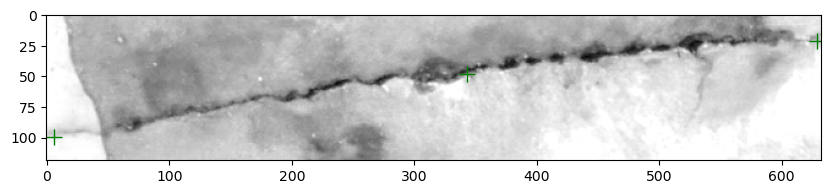

In [6]:
color_channel = 2

ct.tools.show_image(image_crop[:,:,color_channel],frame_size = 10, pts = pts_crop)

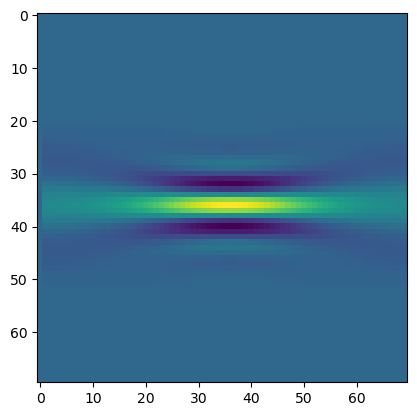

In [7]:
size = 70
nOrientations = 32
design = "N"
inflectionPoint = 0.3
mnOrder = 8
splineOrder = 3
overlapFactor = 1
dcStdDev = 8
directional = False
window_size = 70

ct.os.CheckWavelet(window_size = window_size, size = size, nOrientations = nOrientations, design = design, 
                inflectionPoint = inflectionPoint, mnOrder = mnOrder, splineOrder = splineOrder,
                overlapFactor = overlapFactor, dcStdDev = dcStdDev, directional = directional,
                display_orientations=[8])

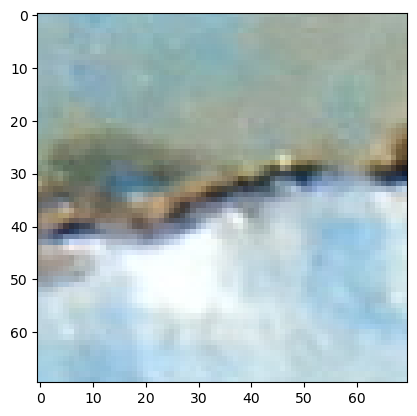

In [8]:
d = int(window_size/2)
fig = plt.figure()
# fig.set_size_inches(18.5, 10.5)
plt.imshow(image[int(pts[2][1])-d:int(pts[2][1])+d,int(pts[2][0])-d:int(pts[2][0])+d],cmap = 'gray')

In [9]:
osGFCost = ct.os.OrientationScoreTransform(image_crop[:,:,color_channel]/255, size = size, 
                                           nOrientations = nOrientations, design = design, 
                                           inflectionPoint = inflectionPoint, mnOrder = mnOrder, 
                                           splineOrder = splineOrder, overlapFactor = overlapFactor, 
                                           dcStdDev = dcStdDev, directional = directional)

In [10]:
ksi = 1
zeta = 1
sigmas = [1,2]
sigmas_ext = 1
multiscalecostLIFExtReg = ct.os.MultiScaleVesselness(osGFCost.real,ksi,1,sigmas,"LIF",sigmas_ext = sigmas_ext)

1
2


In [44]:
costmultiscale = ct.os.MultiScaleVesselnessFilter(multiscalecostLIFExtReg)
costFunction = ct.os.CostFunction(costmultiscale,lambdaa = 100, p = 2)
c00 = np.min(ct.os.Rescale(costFunction),axis = 0)

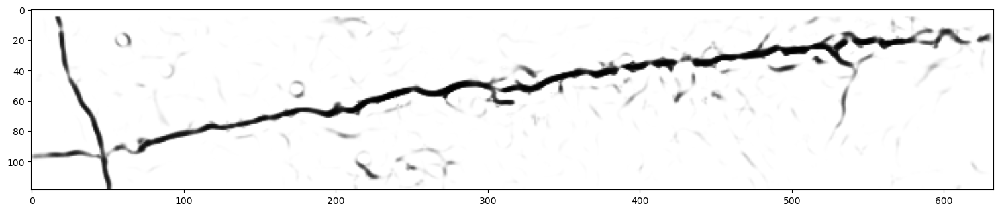

In [45]:
fig = plt.figure()
fig.set_size_inches(18.5, 10.5)
plt.imshow(c00,cmap = 'gray')

In [48]:
track_crop = ct.tracking.fast_marching(costFunction,pts_crop[0],pts_crop[1],g11=1,g22=100,g33=100)

track = ct.tools.track_crop_to_full(track_crop,pts[0],pts[1],y_margin,x_margin)

Field verbosity defaults to 1
Field order defaults to 1
Field seedRadius defaults to 0
Fast marching solver completed in 6.176 s.
Field geodesicSolver defaults to Discrete
Field geodesicStep defaults to 0.25
Field geodesicWeightThreshold defaults to 0.001
Field geodesicVolumeBound defaults to 10.985
Done.


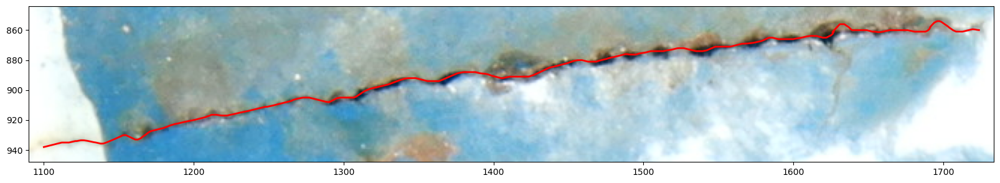

In [49]:
ct.tools.draw_track(image,track,frame_size = 20,limits_x = 10, limits_y = 10,track_color = 'r',track_width = 2)